In [1]:
import tensorflow as tf

In [2]:
from __future__ import print_function
from scipy.misc import imsave
from scipy.optimize import fmin_l_bfgs_b
import numpy as np
import time
from keras.applications import vgg19
from keras import backend as K

from keras.preprocessing import image
from keras.models import Model
from keras.applications.vgg19 import preprocess_input

import matplotlib.pyplot as plt

%matplotlib inline

Using TensorFlow backend.


In [3]:
#Preprocessing des données
content = image.load_img("chien.jpg")
content_array = image.img_to_array(content)

height = content_array.shape[0]
width = content_array.shape[1]

style = image.load_img("style.jpg", target_size=(height,width))
style_array = image.img_to_array(style)

content_array = np.expand_dims(content_array, axis=0)
content_array = preprocess_input(content_array)

style_array = np.expand_dims(style_array, axis=0)
style_array = preprocess_input(style_array)

assert content_array.shape == style_array.shape

generated = K.placeholder(shape=(1,height, width, 3))
content = K.variable(content_array)
style = K.variable(style_array)

print("Height :",height)
print("Width :", width)

Height : 467
Width : 700


In [4]:
#Création du modèle
model = vgg19.VGG19(weights='imagenet', input_tensor=K.concatenate([content,style,generated], axis=0),include_top=False)

In [5]:
#Calcul matrice de Gram
def gram(tensor):
    arranged = K.permute_dimensions(tensor, (2,0,1))
    arranged = K.batch_flatten(arranged)
    return K.dot(arranged, K.transpose(arranged))

In [6]:
def style_loss(gram_style,gram_generated,shape):
    Ml = shape[1] * shape[2]
    Nl = shape[3]
    return K.sum(K.square(gram_generated - gram_style))/(4.*(Ml ** 2) * (Nl ** 2))

In [7]:
def content_loss(content,generated):
    return K.sum(K.square(generated - content))/2.

In [8]:
layers_name = [layer.name for layer in model.layers]
layers_style = ["block1_conv1", "block2_conv1", "block3_conv1", "block4_conv1", "block5_conv1"]
layers_content = ["block4_conv1"]

In [9]:
dict_shape = {}
for name in layers_name:
    dict_shape[name] = model.get_layer(name).output_shape
    
print(dict_shape)

{'block2_conv1': (3, 233, 350, 128), 'input_1': (3, 467, 700, 3), 'block4_conv3': (3, 58, 87, 512), 'block1_conv2': (3, 467, 700, 64), 'block3_pool': (3, 58, 87, 256), 'block5_conv4': (3, 29, 43, 512), 'block2_pool': (3, 116, 175, 128), 'block5_conv2': (3, 29, 43, 512), 'block4_conv4': (3, 58, 87, 512), 'block1_pool': (3, 233, 350, 64), 'block3_conv4': (3, 116, 175, 256), 'block3_conv2': (3, 116, 175, 256), 'block1_conv1': (3, 467, 700, 64), 'block4_conv2': (3, 58, 87, 512), 'block5_pool': (3, 14, 21, 512), 'block5_conv3': (3, 29, 43, 512), 'block3_conv3': (3, 116, 175, 256), 'block3_conv1': (3, 116, 175, 256), 'block4_conv1': (3, 58, 87, 512), 'block5_conv1': (3, 29, 43, 512), 'block4_pool': (3, 29, 43, 512), 'block2_conv2': (3, 233, 350, 128)}


In [10]:
model_dict = dict((name,model.get_layer(name).output) for name in layers_name)

In [11]:
#Construction de la loss de style
loss_variable = K.variable(0)
content_coeff = 0.0001 #content
style_coeff = 1 #style

loss_style_variable = K.variable(0)
for name in layers_style:
    layer = model_dict[name]
    layer_generated = layer[2,:,:,:]
    layer_style = layer[1,:,:,:]
    
    gram_style = gram(layer_style)
    gram_generated = gram(layer_generated)
    
    shape = dict_shape[name]
    print(shape)
    loss_style_variable +=  (style_loss(gram_style, gram_generated,shape)/len(layers_style))

(3, 467, 700, 64)
(3, 233, 350, 128)
(3, 116, 175, 256)
(3, 58, 87, 512)
(3, 29, 43, 512)


In [12]:
#Construction de la loss de content
loss_content_variable = K.variable(0.)
for name in layers_content:
    layer = model_dict[name]
    layer_generated = layer[2,:,:,:]
    layer_content = layer[0,:,:,:]
    loss_content_variable += (content_loss(layer_content, layer_generated)) / len(layers_content)

In [14]:
#Construction de la loss globale
total_loss = content_coeff * loss_content_variable + style_coeff * loss_style_variable

In [15]:
gradients = K.gradients(total_loss, generated)[0]

In [51]:
evaluate_loss_grads = K.function([generated], [total_loss, gradients])

In [16]:
#Reconstruction de l'image d'origine
def build_img(img_data, height, width):
    img = img_data.reshape((height, width, 3))

    img[:, :, 0] += 103.939
    img[:, :, 1] += 116.779
    img[:, :, 2] += 123.68
    
    
    img = img[:, :, ::-1]
    img = np.clip(img, 0, 255).astype('uint8')
    return img

In [17]:
#Génération d'une image aléatoire 
img_data = np.random.uniform(110,150,((1, height, width,3)))
img_data = preprocess_input(img_data)

In [54]:
#Nesterov acceleration
iterate = K.function([generated], [gradients, total_loss])
num_epoch = 100
losses = []
import math

smooth_number = 550.
lambdas = [0]
for i in range(num_epoch + 1):
    last_lambda = lambdas[i]
    new_lambda = (1. + math.sqrt(1. + 4.*(last_lambda**2.) ))/2.
    lambdas.append(new_lambda)
print(lambdas)

gammas = [(1. - lambdas[i])/lambdas[i+1] for i in range(len(lambdas) - 1)]

ys = [0.]
print(gammas)

[0, 1.0, 1.618033988749895, 2.193527085331054, 2.749791340120445, 3.2948796779470473, 3.83260140013, 4.365078717475032, 4.8936217645302005, 5.419098898607719, 5.942116580237085, 6.463115750438564, 6.982427415989093, 7.500306608967648, 8.016954119091308, 8.53253094283583, 9.047168203004484, 9.56097414704707, 10.074039201951413, 10.586439701027011, 11.098240681522611, 11.609498018587676, 12.120260076417877, 12.630569002318444, 13.14046175273386, 13.64997091536941, 14.159125374284798, 14.667950852706811, 15.176470359641057, 15.684704560084912, 16.192672084038094, 16.700389786088067, 17.20787296478144, 17.71513554904683, 18.222190257445686, 18.72904873487776, 19.235721670472856, 19.742218899698106, 20.248549493155114, 20.754721834099627, 21.260743686362773, 21.76662225406786, 22.27236423430589, 22.77797586374463, 23.28346295999212, 23.78883095840848, 24.29408494495499, 24.799229685582393, 25.304269652587454, 25.80920904830608, 26.31405182646003, 26.81880171143102, 27.32346221569944, 27.828

Epoch :  0
1.02066e+10


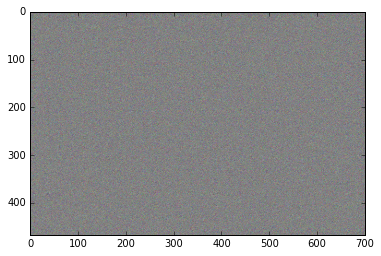

Epoch :  1
9.33106e+09
Epoch :  2
6.08868e+09
Epoch :  3
3.62632e+09
Epoch :  4
3.1985e+09
Epoch :  5
3.91005e+09
Epoch :  6
3.19819e+09
Epoch :  7
1.72676e+09
Epoch :  8
1.38204e+09
Epoch :  9
1.21039e+09
Epoch :  10
1.12261e+09
Epoch :  11
1.13824e+09
Epoch :  12
1.14169e+09
Epoch :  13
1.18242e+09
Epoch :  14
1.19721e+09
Epoch :  15
1.23894e+09
Epoch :  16
1.25815e+09
Epoch :  17
1.30189e+09
Epoch :  18
1.32549e+09
Epoch :  19
1.37051e+09
Epoch :  20
1.39689e+09


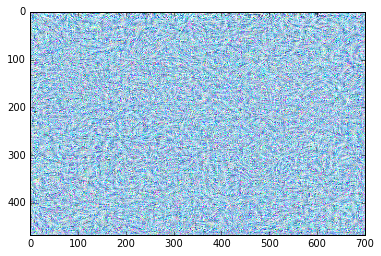

Epoch :  21
1.44386e+09
Epoch :  22
1.47416e+09
Epoch :  23
1.5238e+09
Epoch :  24
1.55846e+09
Epoch :  25
1.61179e+09
Epoch :  26
1.65319e+09
Epoch :  27
1.70346e+09
Epoch :  28
1.75264e+09
Epoch :  29
1.79393e+09
Epoch :  30
1.84936e+09
Epoch :  31
1.87091e+09
Epoch :  32
1.92128e+09
Epoch :  33
1.92441e+09
Epoch :  34
1.96273e+09
Epoch :  35
1.96408e+09
Epoch :  36
1.99899e+09
Epoch :  37
2.00458e+09
Epoch :  38
2.04773e+09
Epoch :  39
2.05948e+09
Epoch :  40
2.11956e+09


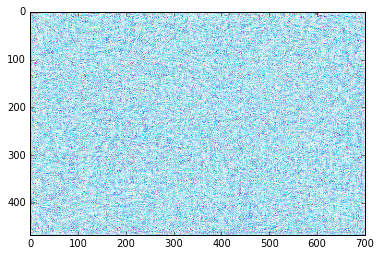

Epoch :  41
2.12601e+09
Epoch :  42
2.20091e+09
Epoch :  43
2.19142e+09
Epoch :  44
2.27097e+09
Epoch :  45
2.23756e+09
Epoch :  46
2.298e+09
Epoch :  47
2.26134e+09
Epoch :  48
2.3204e+09
Epoch :  49
2.30444e+09
Epoch :  50
2.39894e+09
Epoch :  51
2.404e+09
Epoch :  52
2.58739e+09
Epoch :  53
2.61274e+09
Epoch :  54
2.94469e+09
Epoch :  55
3.03982e+09
Epoch :  56
3.49851e+09
Epoch :  57
4.02919e+09
Epoch :  58
4.15967e+09
Epoch :  59
5.17428e+09
Epoch :  60
4.83629e+09


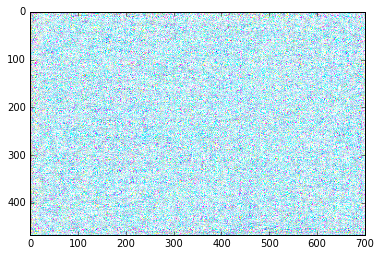

Epoch :  61
6.36841e+09
Epoch :  62
5.31617e+09
Epoch :  63
5.58872e+09
Epoch :  64
5.54646e+09
Epoch :  65
5.28838e+09
Epoch :  66
5.19683e+09
Epoch :  67
4.277e+09
Epoch :  68
3.93695e+09
Epoch :  69
3.83222e+09
Epoch :  70
4.05377e+09
Epoch :  71
3.97013e+09
Epoch :  72
4.23825e+09
Epoch :  73
3.56493e+09
Epoch :  74
3.29802e+09
Epoch :  75
3.14887e+09
Epoch :  76
3.04787e+09
Epoch :  77
3.02475e+09
Epoch :  78
3.06061e+09
Epoch :  79
3.18928e+09
Epoch :  80
3.45835e+09


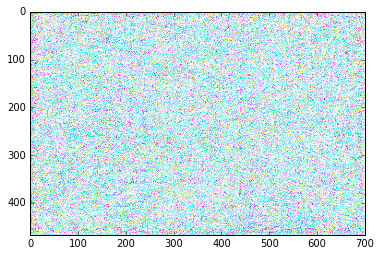

Epoch :  81
3.31177e+09
Epoch :  82
3.16364e+09
Epoch :  83
2.92089e+09
Epoch :  84
2.91375e+09
Epoch :  85
3.02267e+09
Epoch :  86
3.2665e+09
Epoch :  87
3.34108e+09
Epoch :  88
3.34184e+09
Epoch :  89
3.10015e+09
Epoch :  90
3.08627e+09
Epoch :  91
3.64248e+09
Epoch :  92
3.79796e+09
Epoch :  93
4.66716e+09
Epoch :  94
3.68519e+09
Epoch :  95
3.90617e+09
Epoch :  96
4.05562e+09
Epoch :  97
4.23204e+09
Epoch :  98
3.68358e+09
Epoch :  99
3.53527e+09


In [55]:
for it in range(num_epoch):
    print("Epoch : " , it)
    
    grads_values, loss_values = iterate([img_data])
    print(loss_values)
    
    losses.append(loss_values)
    
    
    ys_1 = img_data - (1. / smooth_number) * grads_values
    ys.append(ys_1)
    current_ys = ys[it]
    
    
    img_data = (1 - gammas[it + 1]) * ys_1 + gammas[it] * ys[it]
    
    if it % 20 == 0:
        img_toshow = build_img(np.copy(img_data),height=height,width=width)
        plt.figure()
        plt.imshow(img_toshow)
        plt.show()



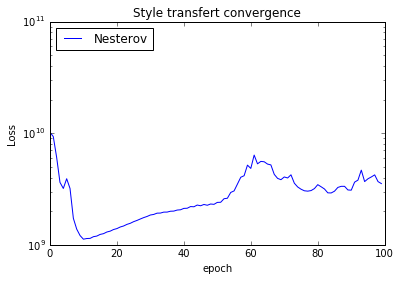

In [56]:
plt.figure()
ax = plt.gca()
ax.set_yscale('log')
plt.plot(losses)

plt.title('Style transfert convergence')
plt.ylabel('Loss')
plt.xlabel('epoch')
plt.legend(['Nesterov'], loc='upper left')

In [18]:
#Fonctions de gradient pour L-BFGS
def evaluate_loss_grads_from_flatten(flatten_input):   
    correct_input = flatten_input.reshape((1, height, width, 3))
    loss, grads= evaluate_loss_grads([correct_input])
    return loss, grads.flatten().astype('float64')


def getLoss(state):
    def getLoss_input(flatten_input):
        loss_values, grads_values = evaluate_loss_grads_from_flatten(flatten_input)
        state["loss"] = loss_values
        state["gradients"] = grads_values.flatten()
        #print("New state : ",state)
        return loss_values
    return getLoss_input

def getGrads(state):
    def getGrads_input(flatten_input):

        grads = state["gradients"]
        return grads.copy()
    
    return getGrads_input

it :  0
{'grad': array([-336.95095825, -297.08544922, -637.68585205, ...,  -57.2647438 ,
        -14.2001009 ,  -65.68548584]), 'funcalls': 6, 'warnflag': 1, 'task': b'STOP: TOTAL NO. of f AND g EVALUATIONS EXCEEDS LIMIT', 'nit': 0}
Final picture : 


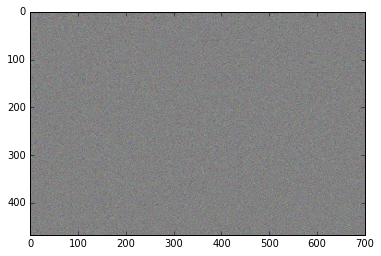

it :  1
{'grad': array([-428.39126587, -360.8604126 , -692.60272217, ...,  -68.53295135,
        -36.79721069,  -70.54462433]), 'funcalls': 6, 'warnflag': 1, 'task': b'STOP: TOTAL NO. of f AND g EVALUATIONS EXCEEDS LIMIT', 'nit': 0}
Final picture : 


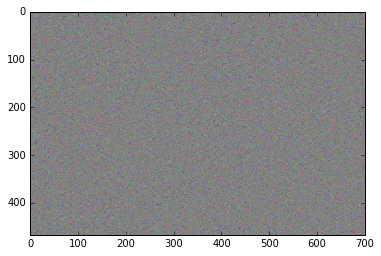

it :  2
{'grad': array([-368.25531006, -276.64996338, -702.48913574, ...,  -71.48179626,
        -35.1354599 ,  -71.70908356]), 'funcalls': 6, 'warnflag': 1, 'task': b'STOP: TOTAL NO. of f AND g EVALUATIONS EXCEEDS LIMIT', 'nit': 0}
Final picture : 


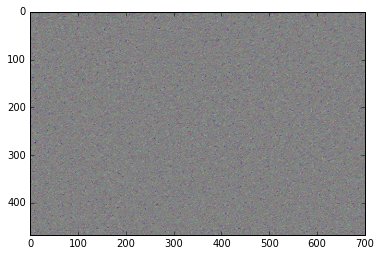

it :  3
{'grad': array([-407.628479  , -286.14877319, -628.0914917 , ...,  -61.6966629 ,
        -24.24048233,  -58.8954277 ]), 'funcalls': 6, 'warnflag': 1, 'task': b'STOP: TOTAL NO. of f AND g EVALUATIONS EXCEEDS LIMIT', 'nit': 0}
Final picture : 


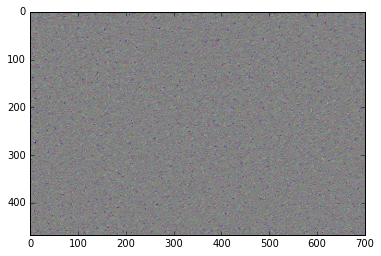

it :  4
{'grad': array([-396.33355713, -269.05108643, -548.77581787, ...,  -48.16928864,
        -20.07275391,  -46.93678284]), 'funcalls': 6, 'warnflag': 1, 'task': b'STOP: TOTAL NO. of f AND g EVALUATIONS EXCEEDS LIMIT', 'nit': 0}
Final picture : 


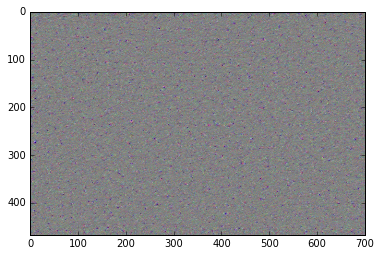

it :  5
{'grad': array([-331.59155273, -184.87467957, -410.67770386, ...,  -32.50810242,
         -9.66898918,  -32.37176514]), 'funcalls': 6, 'warnflag': 1, 'task': b'STOP: TOTAL NO. of f AND g EVALUATIONS EXCEEDS LIMIT', 'nit': 0}
Final picture : 


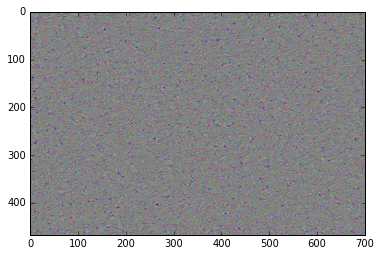

it :  6
{'grad': array([-239.72555542, -119.65499115, -271.69354248, ...,  -24.63839912,
        -12.18088341,  -25.78999138]), 'funcalls': 6, 'warnflag': 1, 'task': b'STOP: TOTAL NO. of f AND g EVALUATIONS EXCEEDS LIMIT', 'nit': 1}
Final picture : 


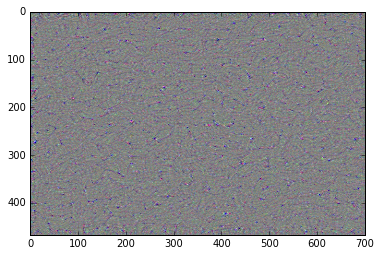

it :  7
{'grad': array([-44.80887604, -59.37483215,  57.17166519, ..., -13.61655998,
        -8.48038006, -12.32916641]), 'funcalls': 6, 'warnflag': 1, 'task': b'STOP: TOTAL NO. of f AND g EVALUATIONS EXCEEDS LIMIT', 'nit': 2}
Final picture : 


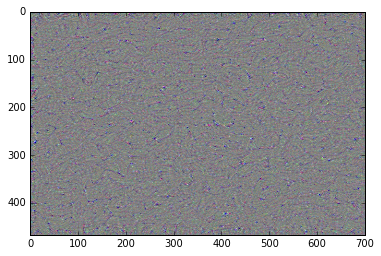

it :  8
{'grad': array([ -7.46979065e+01,  -1.16541199e+02,  -1.01014137e-01, ...,
        -3.19692469e+00,   2.42655134e+00,  -2.23869896e+00]), 'funcalls': 6, 'warnflag': 1, 'task': b'STOP: TOTAL NO. of f AND g EVALUATIONS EXCEEDS LIMIT', 'nit': 2}
Final picture : 


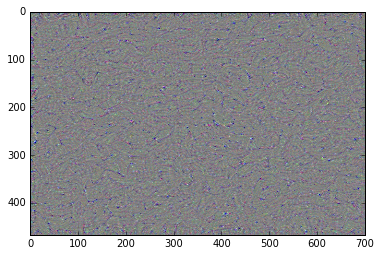

it :  9
{'grad': array([-121.5599823 , -101.4977417 ,  -66.18871307, ...,  -11.00486279,
         -3.62613702,  -13.2773695 ]), 'funcalls': 6, 'warnflag': 1, 'task': b'STOP: TOTAL NO. of f AND g EVALUATIONS EXCEEDS LIMIT', 'nit': 2}
Final picture : 


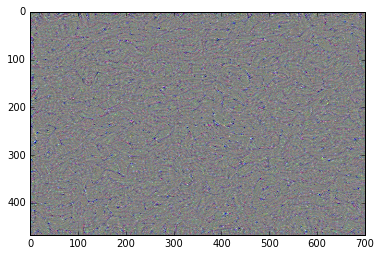

it :  10
{'grad': array([ -75.06771851, -103.48977661,  -20.55735016, ...,   -3.49723315,
         -0.97831881,   -3.3435204 ]), 'funcalls': 6, 'warnflag': 1, 'task': b'STOP: TOTAL NO. of f AND g EVALUATIONS EXCEEDS LIMIT', 'nit': 2}
Final picture : 


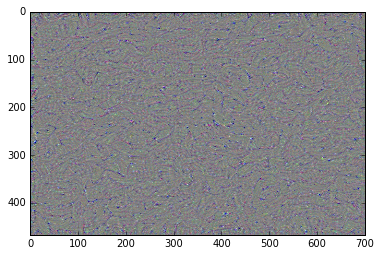

it :  11
{'grad': array([-90.06164551, -83.55960083, -35.01212311, ...,  -7.84075308,
        -4.08724594,  -8.63823605]), 'funcalls': 6, 'warnflag': 1, 'task': b'STOP: TOTAL NO. of f AND g EVALUATIONS EXCEEDS LIMIT', 'nit': 2}
Final picture : 


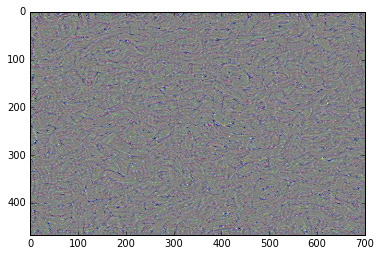

it :  12
{'grad': array([-56.28587341, -86.2063446 ,  -5.77165508, ...,  -2.11304069,
        -1.08498287,  -1.84717441]), 'funcalls': 6, 'warnflag': 1, 'task': b'STOP: TOTAL NO. of f AND g EVALUATIONS EXCEEDS LIMIT', 'nit': 2}
Final picture : 


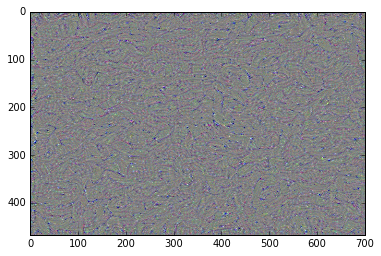

it :  13
{'grad': array([-81.83435059, -70.07577515, -35.9339447 , ...,  -6.26324701,
        -3.88459921,  -8.45648003]), 'funcalls': 6, 'warnflag': 1, 'task': b'STOP: TOTAL NO. of f AND g EVALUATIONS EXCEEDS LIMIT', 'nit': 3}
Final picture : 


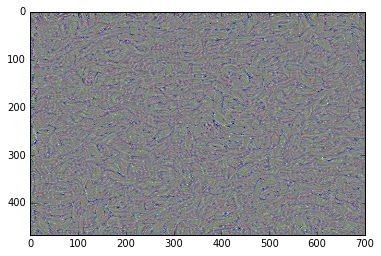

it :  14
{'grad': array([-24.6037159 , -31.11497879,  17.50426865, ...,  -0.81043023,
        -1.42475867,  -2.45896101]), 'funcalls': 6, 'warnflag': 1, 'task': b'STOP: TOTAL NO. of f AND g EVALUATIONS EXCEEDS LIMIT', 'nit': 2}
Final picture : 


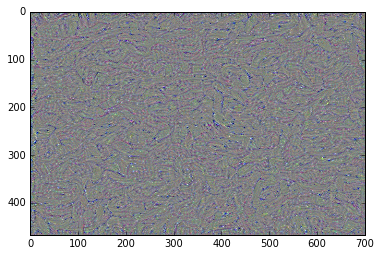

it :  15
{'grad': array([-50.74340439, -41.46326828, -19.2101593 , ...,  -5.09432888,
        -3.37605   ,  -8.02972031]), 'funcalls': 6, 'warnflag': 1, 'task': b'STOP: TOTAL NO. of f AND g EVALUATIONS EXCEEDS LIMIT', 'nit': 3}
Final picture : 


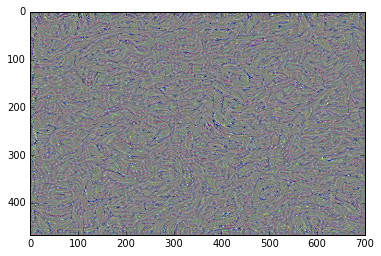

it :  16
{'grad': array([ -7.01591492, -23.17716217,  12.94176388, ...,  -0.62038416,
        -0.56698304,  -1.69396496]), 'funcalls': 6, 'warnflag': 1, 'task': b'STOP: TOTAL NO. of f AND g EVALUATIONS EXCEEDS LIMIT', 'nit': 3}
Final picture : 


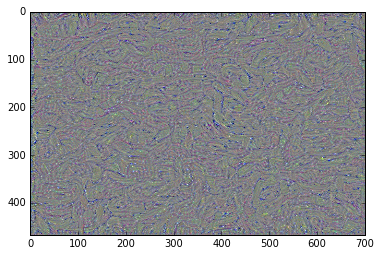

it :  17
{'grad': array([  1.19025111, -13.0306778 ,  15.47387028, ...,  -0.67405879,
        -1.20128202,  -0.71905053]), 'funcalls': 6, 'warnflag': 1, 'task': b'STOP: TOTAL NO. of f AND g EVALUATIONS EXCEEDS LIMIT', 'nit': 3}
Final picture : 


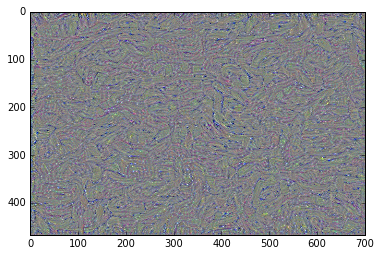

it :  18
{'grad': array([ -7.59339523, -12.07403088,  -4.37018013, ...,  -1.14579022,
        -1.1503793 ,  -2.00047922]), 'funcalls': 6, 'warnflag': 1, 'task': b'STOP: TOTAL NO. of f AND g EVALUATIONS EXCEEDS LIMIT', 'nit': 3}
Final picture : 


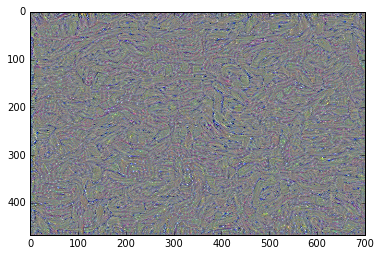

it :  19
{'grad': array([ 13.44392395,   2.89738274,  16.46372986, ...,  -0.29783505,
        -0.94094729,  -0.09270112]), 'funcalls': 6, 'warnflag': 1, 'task': b'STOP: TOTAL NO. of f AND g EVALUATIONS EXCEEDS LIMIT', 'nit': 3}
Final picture : 


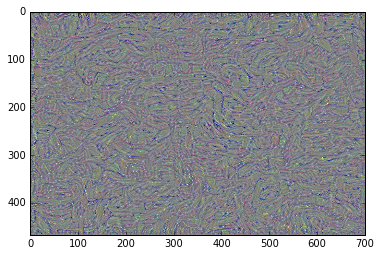

it :  20
{'grad': array([-7.21071053, -8.80796146, -8.79458714, ..., -1.42727232,
       -1.44274783, -2.09238124]), 'funcalls': 6, 'warnflag': 1, 'task': b'STOP: TOTAL NO. of f AND g EVALUATIONS EXCEEDS LIMIT', 'nit': 3}
Final picture : 


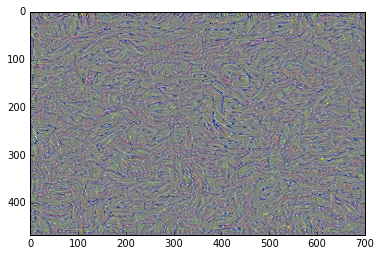

it :  21
{'grad': array([ 6.70423889, -1.58537531,  9.54612541, ..., -0.2181412 ,
       -0.63452375,  0.05919522]), 'funcalls': 6, 'warnflag': 1, 'task': b'STOP: TOTAL NO. of f AND g EVALUATIONS EXCEEDS LIMIT', 'nit': 3}
Final picture : 


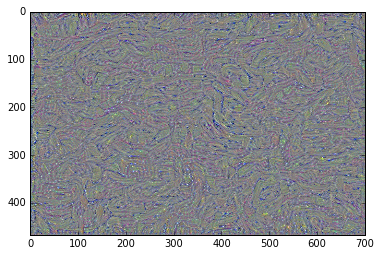

it :  22
{'grad': array([-6.16041613, -8.16866875, -8.48177147, ..., -0.94343448,
       -1.26031828, -1.52028561]), 'funcalls': 6, 'warnflag': 1, 'task': b'STOP: TOTAL NO. of f AND g EVALUATIONS EXCEEDS LIMIT', 'nit': 3}
Final picture : 


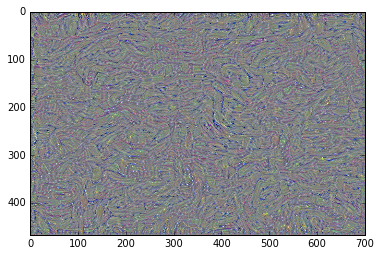

it :  23
{'grad': array([ 5.9200716 ,  1.5623343 ,  3.35535097, ..., -0.24423558,
       -0.59274089, -0.27634752]), 'funcalls': 6, 'warnflag': 1, 'task': b'STOP: TOTAL NO. of f AND g EVALUATIONS EXCEEDS LIMIT', 'nit': 3}
Final picture : 


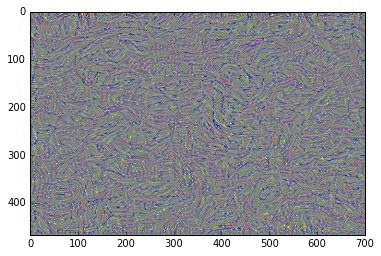

it :  24
{'grad': array([-2.02270579, -5.53270435, -6.16390657, ..., -0.46084499,
       -0.63755935, -0.74661714]), 'funcalls': 6, 'warnflag': 1, 'task': b'STOP: TOTAL NO. of f AND g EVALUATIONS EXCEEDS LIMIT', 'nit': 3}
Final picture : 


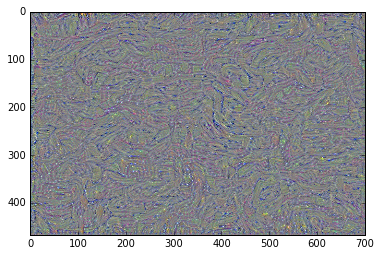

it :  25
{'grad': array([ 8.9454174 ,  5.05409575,  8.22163391, ...,  0.24127492,
       -0.05401701,  0.70083308]), 'funcalls': 6, 'warnflag': 1, 'task': b'STOP: TOTAL NO. of f AND g EVALUATIONS EXCEEDS LIMIT', 'nit': 3}
Final picture : 


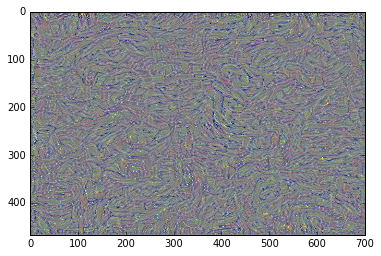

it :  26
{'grad': array([ -0.96532613,  -5.01515532, -10.81494904, ...,  -0.61679304,
        -0.82540047,  -0.91695172]), 'funcalls': 6, 'warnflag': 1, 'task': b'STOP: TOTAL NO. of f AND g EVALUATIONS EXCEEDS LIMIT', 'nit': 4}
Final picture : 


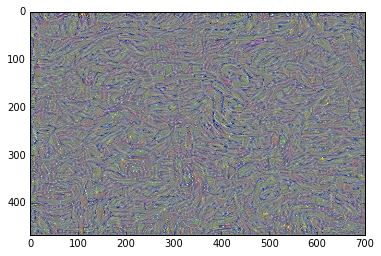

it :  27
{'grad': array([ 4.01496887,  0.77952534, -3.79780531, ..., -0.40909052,
       -0.59621584, -0.55073863]), 'funcalls': 6, 'warnflag': 1, 'task': b'STOP: TOTAL NO. of f AND g EVALUATIONS EXCEEDS LIMIT', 'nit': 3}
Final picture : 


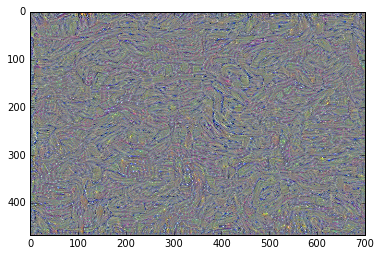

it :  28
{'grad': array([ 6.19607306,  0.91092265,  2.25841808, ...,  0.49782515,
        0.26123723,  1.17341244]), 'funcalls': 6, 'warnflag': 1, 'task': b'STOP: TOTAL NO. of f AND g EVALUATIONS EXCEEDS LIMIT', 'nit': 3}
Final picture : 


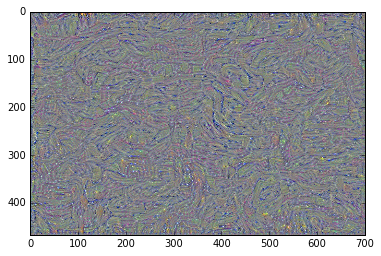

it :  29
{'grad': array([ 3.20986605,  0.05564809, -9.37844086, ..., -0.65205872,
       -0.73227262, -1.01991785]), 'funcalls': 6, 'warnflag': 1, 'task': b'STOP: TOTAL NO. of f AND g EVALUATIONS EXCEEDS LIMIT', 'nit': 3}
Final picture : 


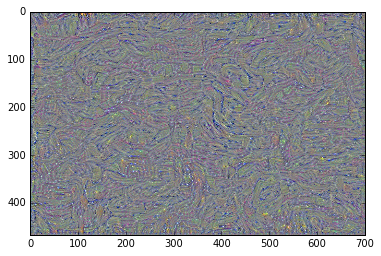

it :  30
{'grad': array([ 5.73783207,  0.28260255, -1.64152849, ...,  0.28174096,
        0.07163143,  0.76121438]), 'funcalls': 6, 'warnflag': 1, 'task': b'STOP: TOTAL NO. of f AND g EVALUATIONS EXCEEDS LIMIT', 'nit': 4}
Final picture : 


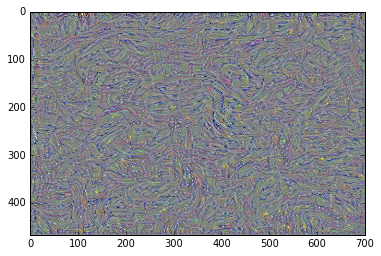

it :  31
{'grad': array([ 4.10582733,  4.8128643 , -6.25610256, ..., -0.52451611,
       -0.61376548, -0.9298529 ]), 'funcalls': 6, 'warnflag': 1, 'task': b'STOP: TOTAL NO. of f AND g EVALUATIONS EXCEEDS LIMIT', 'nit': 3}
Final picture : 


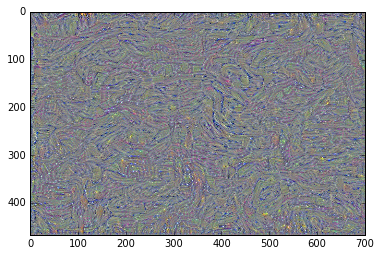

it :  32
{'grad': array([ 6.70043755,  1.68556833, -2.55993867, ...,  0.05607491,
       -0.10494981,  0.59729379]), 'funcalls': 6, 'warnflag': 1, 'task': b'STOP: TOTAL NO. of f AND g EVALUATIONS EXCEEDS LIMIT', 'nit': 3}
Final picture : 


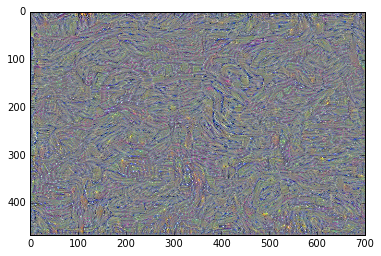

it :  33
{'grad': array([ 2.34986973,  2.97172475, -5.10810566, ..., -0.49838537,
       -0.40068802, -0.82344335]), 'funcalls': 6, 'warnflag': 1, 'task': b'STOP: TOTAL NO. of f AND g EVALUATIONS EXCEEDS LIMIT', 'nit': 3}
Final picture : 


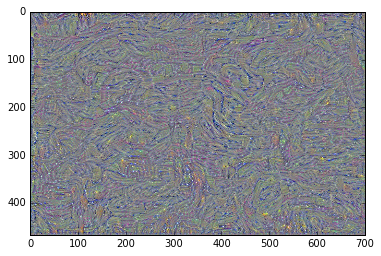

it :  34
{'grad': array([ 10.96155643,   3.58245873,   3.3096745 , ...,   0.23285575,
        -0.09335151,   1.34847414]), 'funcalls': 6, 'warnflag': 1, 'task': b'STOP: TOTAL NO. of f AND g EVALUATIONS EXCEEDS LIMIT', 'nit': 3}
Final picture : 


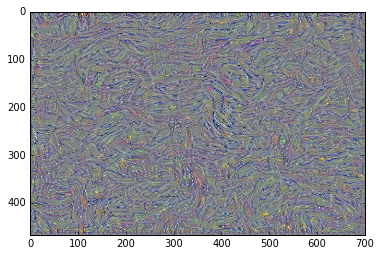

it :  35
{'grad': array([ 3.09032178,  3.12773514, -3.52084708, ..., -0.50050712,
       -0.38235602, -0.81424284]), 'funcalls': 6, 'warnflag': 1, 'task': b'STOP: TOTAL NO. of f AND g EVALUATIONS EXCEEDS LIMIT', 'nit': 4}
Final picture : 


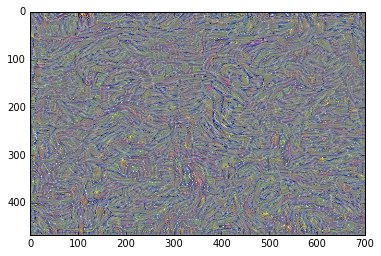

it :  36
{'grad': array([ 1.49900329,  0.45920864, -5.01387882, ..., -0.40574372,
       -0.39899811, -0.61741251]), 'funcalls': 6, 'warnflag': 1, 'task': b'STOP: TOTAL NO. of f AND g EVALUATIONS EXCEEDS LIMIT', 'nit': 3}
Final picture : 


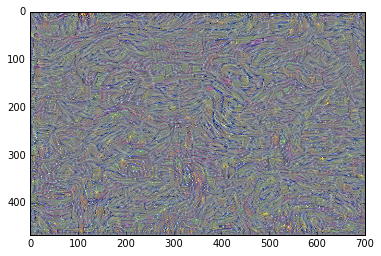

it :  37
{'grad': array([ 6.50980043,  4.84308004,  1.00758231, ..., -0.26857176,
       -0.19557168, -0.19693868]), 'funcalls': 6, 'warnflag': 1, 'task': b'STOP: TOTAL NO. of f AND g EVALUATIONS EXCEEDS LIMIT', 'nit': 4}
Final picture : 


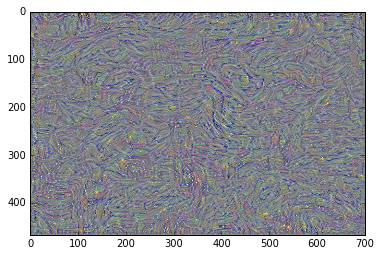

it :  38
{'grad': array([ 3.75059605,  1.91466308, -2.2433331 , ..., -0.32918391,
       -0.30142766, -0.29595232]), 'funcalls': 6, 'warnflag': 1, 'task': b'STOP: TOTAL NO. of f AND g EVALUATIONS EXCEEDS LIMIT', 'nit': 4}
Final picture : 


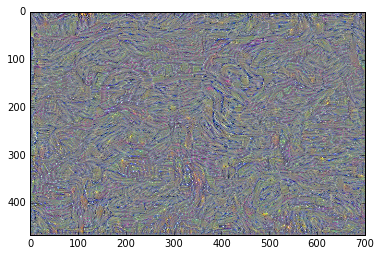

it :  39
{'grad': array([ 2.13856077,  1.56963944, -2.36595106, ..., -0.41547805,
       -0.25048253, -0.55861592]), 'funcalls': 6, 'warnflag': 1, 'task': b'STOP: TOTAL NO. of f AND g EVALUATIONS EXCEEDS LIMIT', 'nit': 4}
Final picture : 


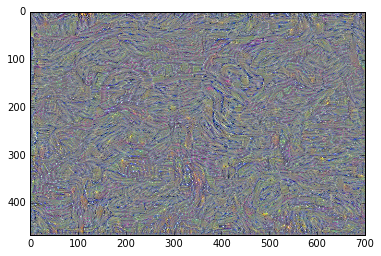

it :  40
{'grad': array([ 2.20896459,  0.94183099, -3.45171356, ..., -0.43623158,
       -0.35869879, -0.62565857]), 'funcalls': 6, 'warnflag': 1, 'task': b'STOP: TOTAL NO. of f AND g EVALUATIONS EXCEEDS LIMIT', 'nit': 3}
Final picture : 


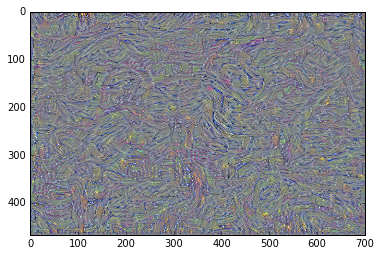

it :  41
{'grad': array([ 3.61107969,  1.16712856,  0.28361362, ..., -0.22618833,
       -0.23471266,  0.14181551]), 'funcalls': 6, 'warnflag': 1, 'task': b'STOP: TOTAL NO. of f AND g EVALUATIONS EXCEEDS LIMIT', 'nit': 4}
Final picture : 


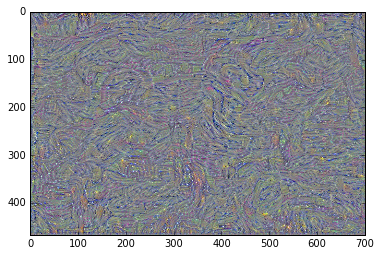

it :  42
{'grad': array([ 3.63818264,  2.29642296, -2.29680252, ..., -0.44124645,
       -0.38230491, -0.61601764]), 'funcalls': 6, 'warnflag': 1, 'task': b'STOP: TOTAL NO. of f AND g EVALUATIONS EXCEEDS LIMIT', 'nit': 4}
Final picture : 


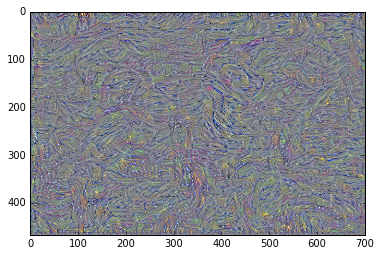

it :  43
{'grad': array([-2.946244  , -2.54196429, -6.06383085, ..., -0.44599593,
       -0.18742459, -0.60089946]), 'funcalls': 6, 'warnflag': 1, 'task': b'STOP: TOTAL NO. of f AND g EVALUATIONS EXCEEDS LIMIT', 'nit': 4}
Final picture : 


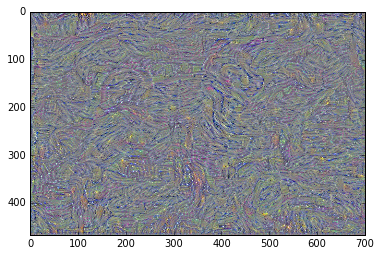

it :  44
{'grad': array([ 2.73316836,  1.75147057, -2.49900484, ..., -0.39457294,
       -0.30438229, -0.55708075]), 'funcalls': 6, 'warnflag': 1, 'task': b'STOP: TOTAL NO. of f AND g EVALUATIONS EXCEEDS LIMIT', 'nit': 4}
Final picture : 


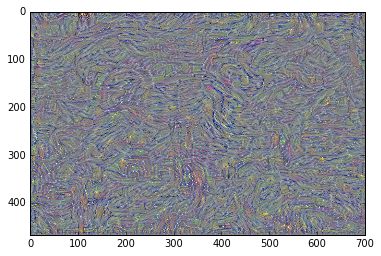

it :  45
{'grad': array([-2.23147154, -1.63092899, -5.41017437, ..., -0.54143745,
       -0.24893476, -0.85302091]), 'funcalls': 6, 'warnflag': 1, 'task': b'STOP: TOTAL NO. of f AND g EVALUATIONS EXCEEDS LIMIT', 'nit': 4}
Final picture : 


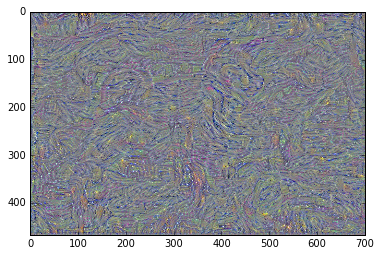

it :  46
{'grad': array([ 1.11174655,  0.25708055, -3.11034036, ..., -0.44041806,
       -0.27511647, -0.57365918]), 'funcalls': 6, 'warnflag': 1, 'task': b'STOP: TOTAL NO. of f AND g EVALUATIONS EXCEEDS LIMIT', 'nit': 3}
Final picture : 


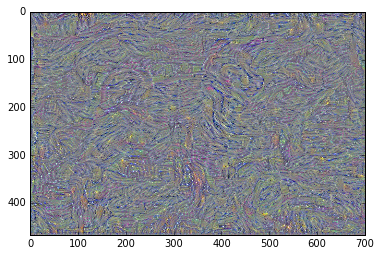

it :  47
{'grad': array([-1.82093394, -1.51881385, -4.69521999, ..., -0.51180077,
       -0.25120622, -0.72889906]), 'funcalls': 6, 'warnflag': 1, 'task': b'STOP: TOTAL NO. of f AND g EVALUATIONS EXCEEDS LIMIT', 'nit': 4}
Final picture : 


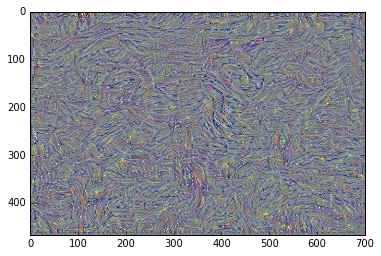

it :  48
{'grad': array([-0.4179647 ,  0.45016605, -5.23380947, ..., -0.61376554,
       -0.35276833, -1.21891177]), 'funcalls': 6, 'warnflag': 1, 'task': b'STOP: TOTAL NO. of f AND g EVALUATIONS EXCEEDS LIMIT', 'nit': 2}
Final picture : 


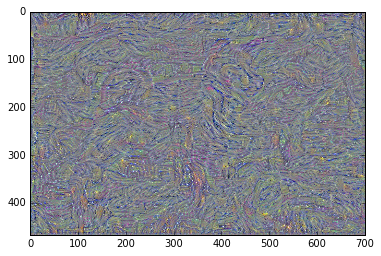

it :  49
{'grad': array([ 3.34369111,  0.62183112,  1.38447845, ..., -0.23451261,
       -0.17490399,  0.30844373]), 'funcalls': 6, 'warnflag': 1, 'task': b'STOP: TOTAL NO. of f AND g EVALUATIONS EXCEEDS LIMIT', 'nit': 4}
Final picture : 


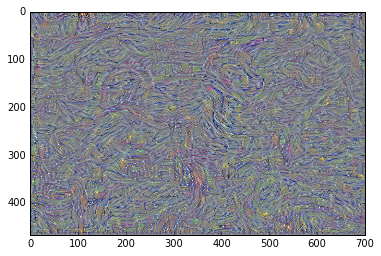

it :  50
{'grad': array([ 1.60917628,  0.59450382, -1.8296814 , ..., -0.36783177,
       -0.26990199, -0.46549013]), 'funcalls': 6, 'warnflag': 1, 'task': b'STOP: TOTAL NO. of f AND g EVALUATIONS EXCEEDS LIMIT', 'nit': 4}
Final picture : 


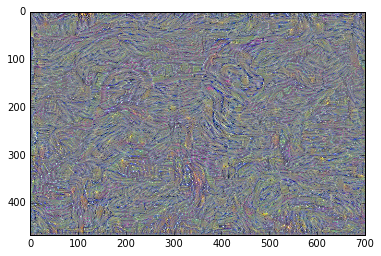

it :  51
{'grad': array([-1.53653145, -1.17719674, -3.88101768, ..., -0.45672026,
       -0.18042377, -0.62065029]), 'funcalls': 6, 'warnflag': 1, 'task': b'STOP: TOTAL NO. of f AND g EVALUATIONS EXCEEDS LIMIT', 'nit': 4}
Final picture : 


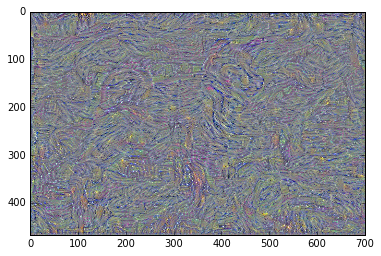

it :  52
{'grad': array([ 3.61425233,  1.21946132,  0.25806004, ..., -0.21361752,
       -0.17784591,  0.10314603]), 'funcalls': 6, 'warnflag': 1, 'task': b'STOP: TOTAL NO. of f AND g EVALUATIONS EXCEEDS LIMIT', 'nit': 3}
Final picture : 


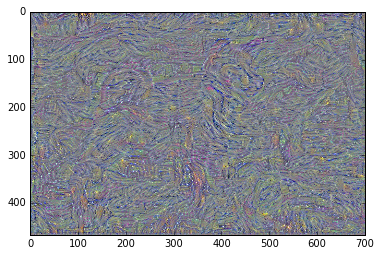

it :  53
{'grad': array([-0.15229315, -0.31071922, -2.99039555, ..., -0.55658066,
       -0.25247568, -0.73631889]), 'funcalls': 6, 'warnflag': 1, 'task': b'STOP: TOTAL NO. of f AND g EVALUATIONS EXCEEDS LIMIT', 'nit': 4}
Final picture : 


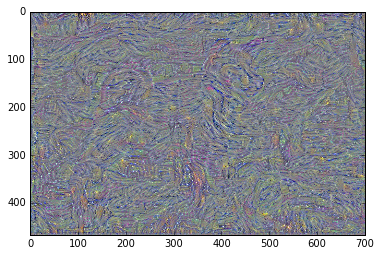

it :  54
{'grad': array([ 3.10133266,  1.17373407, -0.41606185, ..., -0.27179721,
       -0.21491152, -0.10176378]), 'funcalls': 6, 'warnflag': 1, 'task': b'STOP: TOTAL NO. of f AND g EVALUATIONS EXCEEDS LIMIT', 'nit': 4}
Final picture : 


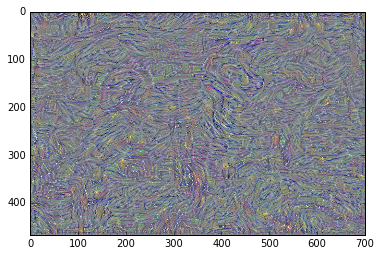

it :  55
{'grad': array([ 1.97613454,  0.72003663, -0.54578769, ..., -0.26245022,
       -0.11573383, -0.04380206]), 'funcalls': 6, 'warnflag': 1, 'task': b'STOP: TOTAL NO. of f AND g EVALUATIONS EXCEEDS LIMIT', 'nit': 4}
Final picture : 


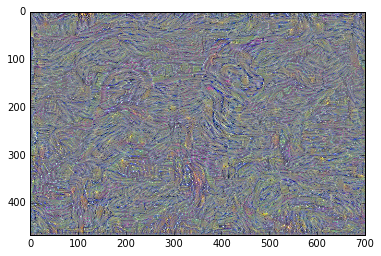

it :  56
{'grad': array([ 9.85004234,  5.43455362,  5.17618895, ...,  0.19612901,
       -0.16838865,  1.10962605]), 'funcalls': 6, 'warnflag': 1, 'task': b'STOP: TOTAL NO. of f AND g EVALUATIONS EXCEEDS LIMIT', 'nit': 3}
Final picture : 


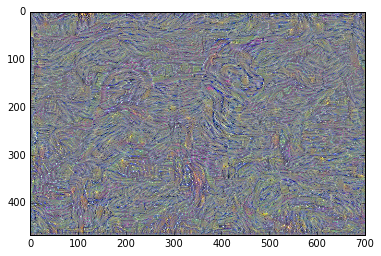

it :  57
{'grad': array([ 0.81542504, -0.21291408, -1.45819926, ..., -0.39167807,
       -0.15785119, -0.43903974]), 'funcalls': 6, 'warnflag': 1, 'task': b'STOP: TOTAL NO. of f AND g EVALUATIONS EXCEEDS LIMIT', 'nit': 4}
Final picture : 


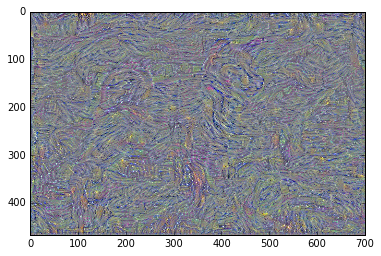

it :  58
{'grad': array([ 1.22005343, -0.09701161, -2.26174068, ..., -0.40424386,
       -0.23659582, -0.56571656]), 'funcalls': 6, 'warnflag': 1, 'task': b'STOP: TOTAL NO. of f AND g EVALUATIONS EXCEEDS LIMIT', 'nit': 4}
Final picture : 


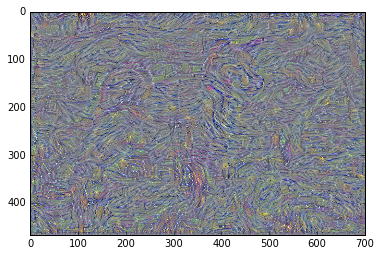

it :  59
{'grad': array([ 1.72195363,  0.39343131,  0.28973225, ..., -0.17668369,
       -0.10517907,  0.16749497]), 'funcalls': 6, 'warnflag': 1, 'task': b'STOP: TOTAL NO. of f AND g EVALUATIONS EXCEEDS LIMIT', 'nit': 3}
Final picture : 


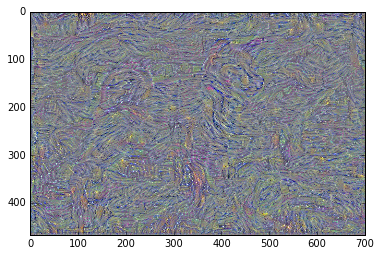

it :  60
{'grad': array([ 1.34723163,  0.02841832, -1.70959079, ..., -0.52346987,
       -0.31516176, -0.81258804]), 'funcalls': 6, 'warnflag': 1, 'task': b'STOP: TOTAL NO. of f AND g EVALUATIONS EXCEEDS LIMIT', 'nit': 4}
Final picture : 


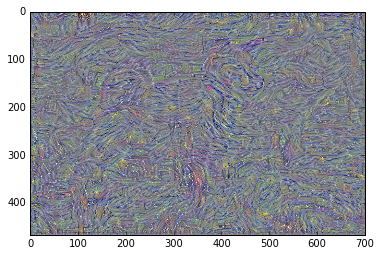

it :  61
{'grad': array([ 1.05642736,  0.04806457, -0.33431581, ..., -0.34597203,
       -0.16365339, -0.22070742]), 'funcalls': 6, 'warnflag': 1, 'task': b'STOP: TOTAL NO. of f AND g EVALUATIONS EXCEEDS LIMIT', 'nit': 4}
Final picture : 


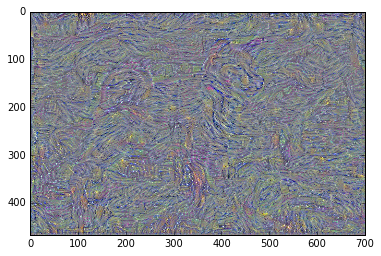

it :  62
{'grad': array([ 2.92026234,  1.21138978,  0.57342398, ..., -0.23934215,
       -0.19305643,  0.01037658]), 'funcalls': 6, 'warnflag': 1, 'task': b'STOP: TOTAL NO. of f AND g EVALUATIONS EXCEEDS LIMIT', 'nit': 4}
Final picture : 


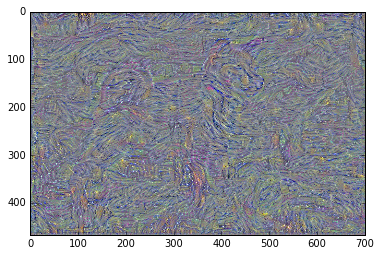

it :  63
{'grad': array([-2.23875904, -2.70118475, -4.07026005, ..., -0.66455483,
       -0.23059896, -1.15183997]), 'funcalls': 6, 'warnflag': 1, 'task': b'STOP: TOTAL NO. of f AND g EVALUATIONS EXCEEDS LIMIT', 'nit': 2}
Final picture : 


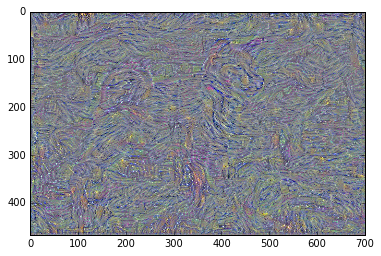

it :  64
{'grad': array([ 3.86031723,  1.99203205,  1.67463946, ..., -0.139503  ,
       -0.19408055,  0.28232571]), 'funcalls': 6, 'warnflag': 1, 'task': b'STOP: TOTAL NO. of f AND g EVALUATIONS EXCEEDS LIMIT', 'nit': 4}
Final picture : 


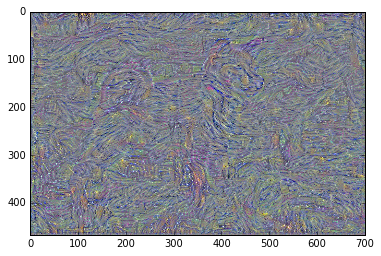

it :  65
{'grad': array([ 0.04267368, -0.61634707, -1.34785187, ..., -0.41975284,
       -0.18833774, -0.47155693]), 'funcalls': 6, 'warnflag': 1, 'task': b'STOP: TOTAL NO. of f AND g EVALUATIONS EXCEEDS LIMIT', 'nit': 4}
Final picture : 


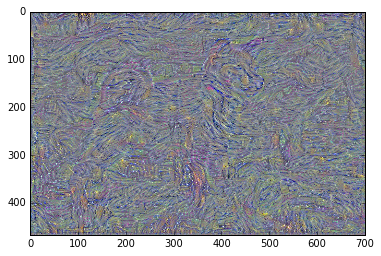

it :  66
{'grad': array([ 1.64571476,  0.55213284, -0.48232216, ..., -0.32018492,
       -0.20452914, -0.26995051]), 'funcalls': 6, 'warnflag': 1, 'task': b'STOP: TOTAL NO. of f AND g EVALUATIONS EXCEEDS LIMIT', 'nit': 4}
Final picture : 


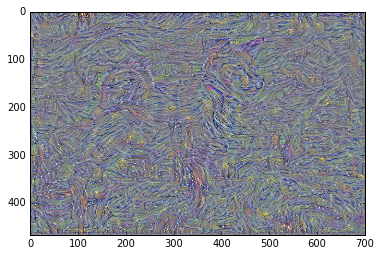

it :  67
{'grad': array([-0.85194463, -1.27532017, -1.92545795, ..., -0.49511954,
       -0.23502193, -0.65915895]), 'funcalls': 6, 'warnflag': 1, 'task': b'STOP: TOTAL NO. of f AND g EVALUATIONS EXCEEDS LIMIT', 'nit': 3}
Final picture : 


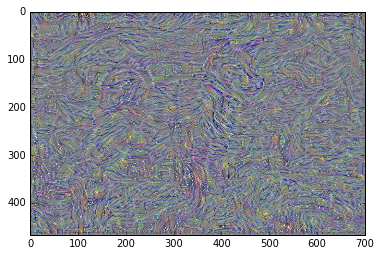

it :  68
{'grad': array([ 5.92672157,  4.39536953,  3.81669331, ...,  0.06808101,
       -0.17170656,  0.74395716]), 'funcalls': 6, 'warnflag': 1, 'task': b'STOP: TOTAL NO. of f AND g EVALUATIONS EXCEEDS LIMIT', 'nit': 4}
Final picture : 


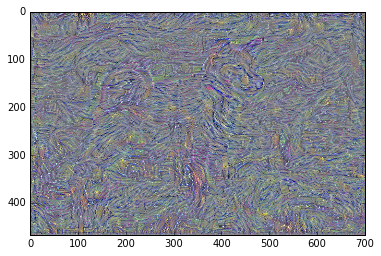

it :  69
{'grad': array([ 0.74634284,  0.58173293,  0.25409186, ..., -0.35589641,
       -0.20900342, -0.2606549 ]), 'funcalls': 6, 'warnflag': 1, 'task': b'STOP: TOTAL NO. of f AND g EVALUATIONS EXCEEDS LIMIT', 'nit': 3}
Final picture : 


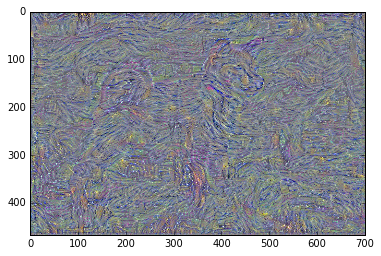

it :  70
{'grad': array([ 0.12164902, -1.48133409, -2.94881248, ..., -0.29492152,
       -0.31345654, -0.15963873]), 'funcalls': 6, 'warnflag': 1, 'task': b'STOP: TOTAL NO. of f AND g EVALUATIONS EXCEEDS LIMIT', 'nit': 4}
Final picture : 


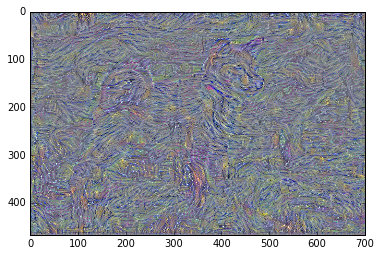

it :  71
{'grad': array([-2.11114836, -1.96594477, -2.99863696, ..., -0.50196081,
       -0.16825145, -0.69448215]), 'funcalls': 6, 'warnflag': 1, 'task': b'STOP: TOTAL NO. of f AND g EVALUATIONS EXCEEDS LIMIT', 'nit': 3}
Final picture : 


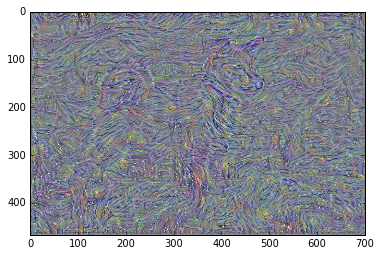

it :  72
{'grad': array([-0.95525384, -1.68498635, -1.66172278, ..., -0.35325581,
       -0.24814966, -0.38406503]), 'funcalls': 6, 'warnflag': 1, 'task': b'STOP: TOTAL NO. of f AND g EVALUATIONS EXCEEDS LIMIT', 'nit': 4}
Final picture : 


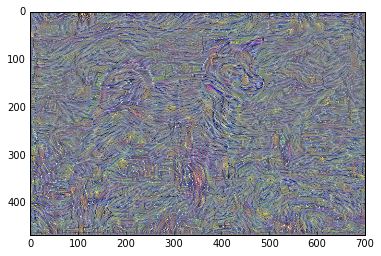

it :  73
{'grad': array([ 0.76313066,  0.30538481,  0.70579994, ..., -0.29384863,
       -0.17544679, -0.17234352]), 'funcalls': 6, 'warnflag': 1, 'task': b'STOP: TOTAL NO. of f AND g EVALUATIONS EXCEEDS LIMIT', 'nit': 4}
Final picture : 


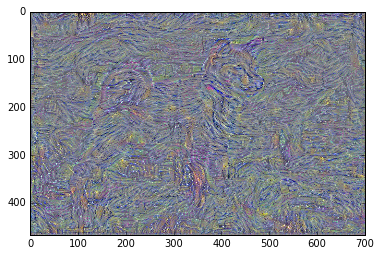

it :  74
{'grad': array([-0.71679842, -0.89486247, -1.34421289, ..., -0.35224617,
       -0.24993794, -0.43061209]), 'funcalls': 6, 'warnflag': 1, 'task': b'STOP: TOTAL NO. of f AND g EVALUATIONS EXCEEDS LIMIT', 'nit': 3}
Final picture : 


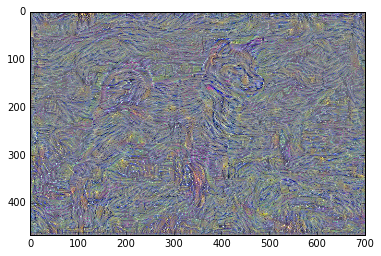

it :  75
{'grad': array([-0.56365728, -1.99770856, -0.39115644, ..., -0.27961776,
       -0.29833642, -0.11104769]), 'funcalls': 6, 'warnflag': 1, 'task': b'STOP: TOTAL NO. of f AND g EVALUATIONS EXCEEDS LIMIT', 'nit': 4}
Final picture : 


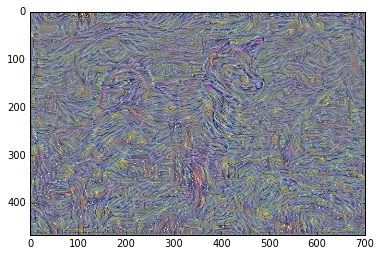

it :  76
{'grad': array([ 1.07034755,  0.59449834,  1.06152582, ..., -0.2632575 ,
       -0.14079916, -0.07841901]), 'funcalls': 6, 'warnflag': 1, 'task': b'STOP: TOTAL NO. of f AND g EVALUATIONS EXCEEDS LIMIT', 'nit': 4}
Final picture : 


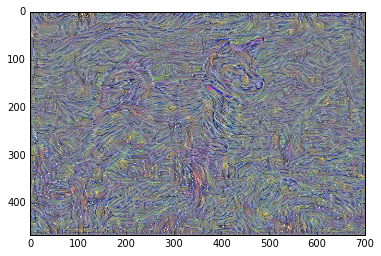

it :  77
{'grad': array([ 0.77704275,  0.13238259,  1.1039511 , ..., -0.17274371,
       -0.20692347,  0.09249507]), 'funcalls': 6, 'warnflag': 1, 'task': b'STOP: TOTAL NO. of f AND g EVALUATIONS EXCEEDS LIMIT', 'nit': 4}
Final picture : 


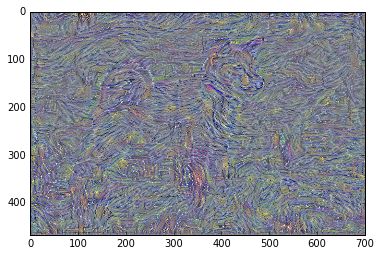

it :  78
{'grad': array([ 1.01760745,  0.75860113,  1.12547112, ..., -0.27314952,
       -0.17118235, -0.10040486]), 'funcalls': 6, 'warnflag': 1, 'task': b'STOP: TOTAL NO. of f AND g EVALUATIONS EXCEEDS LIMIT', 'nit': 4}
Final picture : 


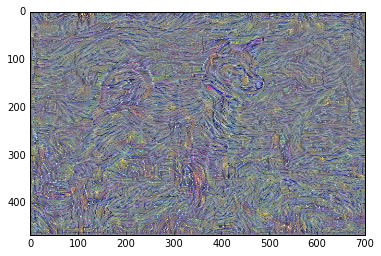

it :  79
{'grad': array([-1.86655354, -1.96566224, -1.81635427, ..., -0.3228142 ,
       -0.3691498 , -0.33577454]), 'funcalls': 6, 'warnflag': 1, 'task': b'STOP: TOTAL NO. of f AND g EVALUATIONS EXCEEDS LIMIT', 'nit': 4}
Final picture : 


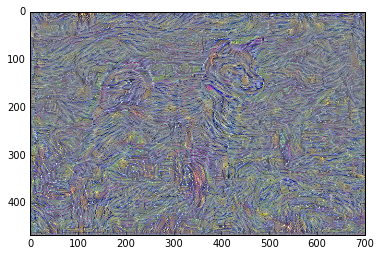

it :  80
{'grad': array([ 2.62330103,  2.01427054,  3.26039076, ..., -0.11959381,
       -0.08409397,  0.29975533]), 'funcalls': 6, 'warnflag': 1, 'task': b'STOP: TOTAL NO. of f AND g EVALUATIONS EXCEEDS LIMIT', 'nit': 3}
Final picture : 


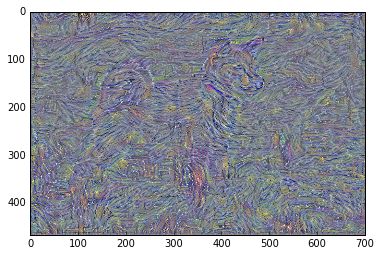

it :  81
{'grad': array([-3.20564032, -3.73556876, -4.43418026, ..., -0.51315302,
       -0.3832691 , -0.71275318]), 'funcalls': 6, 'warnflag': 1, 'task': b'STOP: TOTAL NO. of f AND g EVALUATIONS EXCEEDS LIMIT', 'nit': 4}
Final picture : 


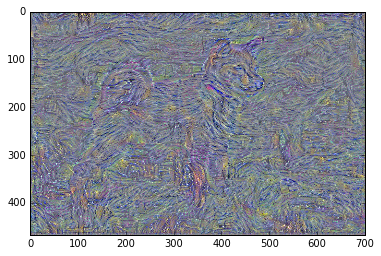

it :  82
{'grad': array([-1.31425643, -1.17636669, -1.61079729, ..., -0.42550448,
       -0.27679047, -0.53812569]), 'funcalls': 6, 'warnflag': 1, 'task': b'STOP: TOTAL NO. of f AND g EVALUATIONS EXCEEDS LIMIT', 'nit': 3}
Final picture : 


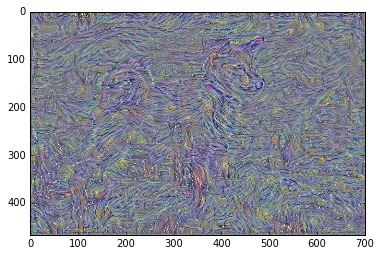

it :  83
{'grad': array([-0.50024867, -1.30511618, -0.47764832, ..., -0.28795522,
       -0.24751531, -0.0778007 ]), 'funcalls': 6, 'warnflag': 1, 'task': b'STOP: TOTAL NO. of f AND g EVALUATIONS EXCEEDS LIMIT', 'nit': 4}
Final picture : 


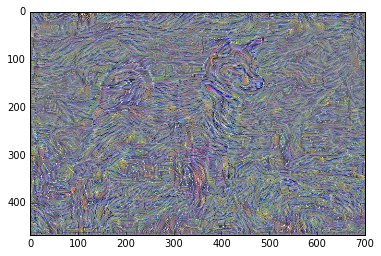

it :  84
{'grad': array([ 0.27266181,  0.58338273,  0.85289198, ..., -0.25563058,
       -0.16882998, -0.12771061]), 'funcalls': 6, 'warnflag': 1, 'task': b'STOP: TOTAL NO. of f AND g EVALUATIONS EXCEEDS LIMIT', 'nit': 4}
Final picture : 


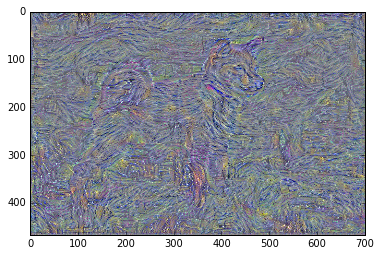

it :  85
{'grad': array([-0.34100771, -0.86541766,  0.00217816, ..., -0.20369236,
       -0.12471649,  0.05311981]), 'funcalls': 6, 'warnflag': 1, 'task': b'STOP: TOTAL NO. of f AND g EVALUATIONS EXCEEDS LIMIT', 'nit': 4}
Final picture : 


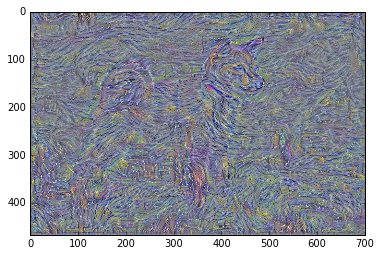

it :  86
{'grad': array([-0.13403741,  0.38014585,  0.72959352, ..., -0.2182636 ,
       -0.15137309, -0.02948345]), 'funcalls': 6, 'warnflag': 1, 'task': b'STOP: TOTAL NO. of f AND g EVALUATIONS EXCEEDS LIMIT', 'nit': 4}
Final picture : 


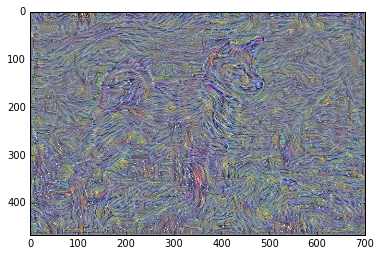

it :  87
{'grad': array([ 0.73402762, -0.15069045,  0.37215543, ..., -0.27935266,
       -0.20258555,  0.00075786]), 'funcalls': 6, 'warnflag': 1, 'task': b'STOP: TOTAL NO. of f AND g EVALUATIONS EXCEEDS LIMIT', 'nit': 4}
Final picture : 


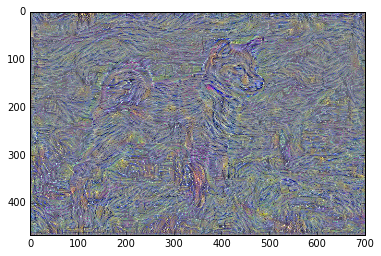

it :  88
{'grad': array([ 0.05703968,  0.62994933,  1.07907736, ..., -0.14064352,
       -0.14167577,  0.0878665 ]), 'funcalls': 6, 'warnflag': 1, 'task': b'STOP: TOTAL NO. of f AND g EVALUATIONS EXCEEDS LIMIT', 'nit': 4}
Final picture : 


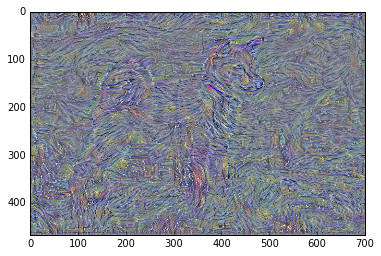

it :  89
{'grad': array([-0.46506211, -0.70429897, -0.83023721, ..., -0.3329736 ,
       -0.20944795, -0.30694786]), 'funcalls': 6, 'warnflag': 1, 'task': b'STOP: TOTAL NO. of f AND g EVALUATIONS EXCEEDS LIMIT', 'nit': 4}
Final picture : 


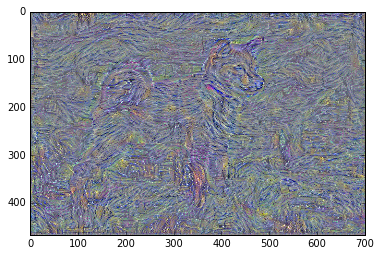

it :  90
{'grad': array([-1.0288378 , -0.42588362, -0.27603778, ..., -0.26185152,
       -0.18524173, -0.22777547]), 'funcalls': 6, 'warnflag': 1, 'task': b'STOP: TOTAL NO. of f AND g EVALUATIONS EXCEEDS LIMIT', 'nit': 4}
Final picture : 


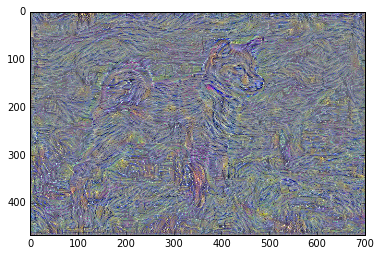

it :  91
{'grad': array([-0.67111093, -0.76845145, -0.83237773, ..., -0.28688097,
       -0.19383293, -0.2002935 ]), 'funcalls': 6, 'warnflag': 1, 'task': b'STOP: TOTAL NO. of f AND g EVALUATIONS EXCEEDS LIMIT', 'nit': 4}
Final picture : 


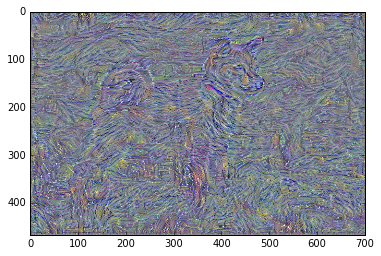

it :  92
{'grad': array([ 1.65548861,  2.02306533,  3.0220077 , ...,  0.05059141,
       -0.11920402,  0.40592897]), 'funcalls': 6, 'warnflag': 1, 'task': b'STOP: TOTAL NO. of f AND g EVALUATIONS EXCEEDS LIMIT', 'nit': 3}
Final picture : 


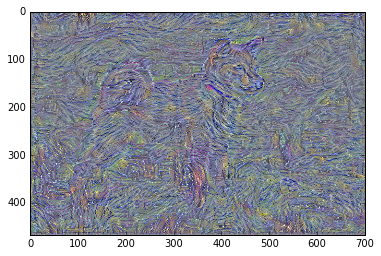

it :  93
{'grad': array([-0.45226115, -0.90131855, -1.03479493, ..., -0.36987039,
       -0.26647377, -0.42650068]), 'funcalls': 6, 'warnflag': 1, 'task': b'STOP: TOTAL NO. of ITERATIONS EXCEEDS LIMIT', 'nit': 4}
Final picture : 


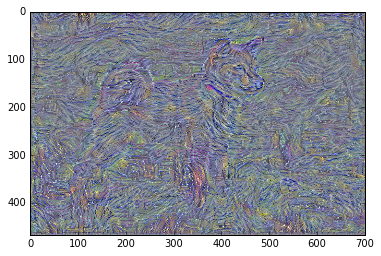

it :  94
{'grad': array([-1.93787897, -0.83739078, -0.73399562, ..., -0.21293315,
       -0.15151657, -0.17060073]), 'funcalls': 6, 'warnflag': 1, 'task': b'STOP: TOTAL NO. of ITERATIONS EXCEEDS LIMIT', 'nit': 4}
Final picture : 


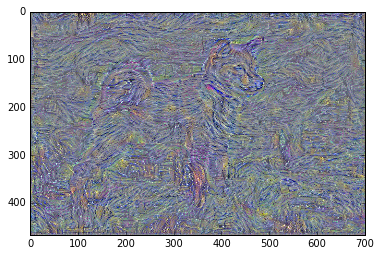

it :  95
{'grad': array([ 0.10129659, -0.22490415, -0.08764461, ..., -0.24983153,
       -0.20400591, -0.22310911]), 'funcalls': 6, 'warnflag': 1, 'task': b'STOP: TOTAL NO. of f AND g EVALUATIONS EXCEEDS LIMIT', 'nit': 4}
Final picture : 


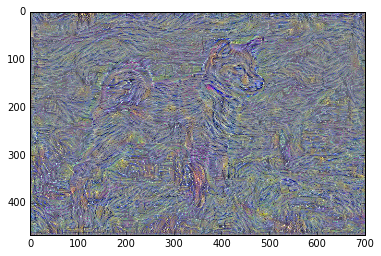

it :  96
{'grad': array([-0.73811781, -0.23227426,  0.02896646, ..., -0.21524991,
       -0.18209858, -0.1727521 ]), 'funcalls': 6, 'warnflag': 1, 'task': b'STOP: TOTAL NO. of f AND g EVALUATIONS EXCEEDS LIMIT', 'nit': 4}
Final picture : 


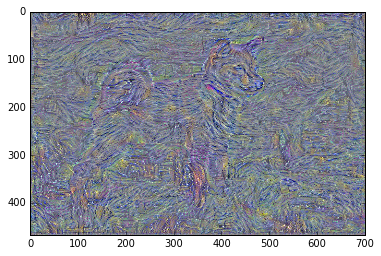

it :  97
{'grad': array([ 0.85444522,  0.12925556,  0.31126174, ..., -0.17055093,
       -0.15318525, -0.05253428]), 'funcalls': 6, 'warnflag': 1, 'task': b'STOP: TOTAL NO. of f AND g EVALUATIONS EXCEEDS LIMIT', 'nit': 4}
Final picture : 


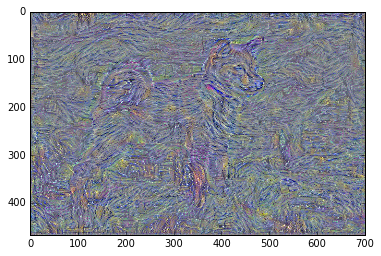

it :  98
{'grad': array([ 0.47915855,  0.94601798,  1.64324665, ..., -0.10265557,
       -0.14315066,  0.06045555]), 'funcalls': 6, 'warnflag': 1, 'task': b'STOP: TOTAL NO. of f AND g EVALUATIONS EXCEEDS LIMIT', 'nit': 4}
Final picture : 


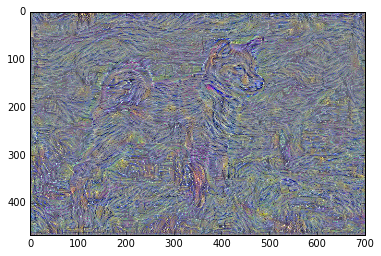

it :  99
{'grad': array([-0.38890988, -0.66335541, -0.91659069, ..., -0.18964732,
       -0.13771451, -0.11355123]), 'funcalls': 6, 'warnflag': 1, 'task': b'STOP: TOTAL NO. of ITERATIONS EXCEEDS LIMIT', 'nit': 4}
Final picture : 


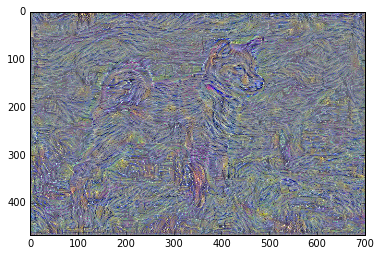

In [58]:
state = {}

img_data = np.random.uniform(110,150,((1, height, width,3)))
img_data = preprocess_input(img_data)


def display(xk):
    print("Current best image :")
    copy = xk.copy()
    copy = copy.reshape((1, height, width, 3))
    img_toshow = build_img(copy,height=height,width=width)
    plt.figure()
    plt.imshow(copy)
    plt.show()

loss_lbfgs = []
for it in range(100):
    min_input, min_val, info = fmin_l_bfgs_b(getLoss(state), img_data.flatten(),fprime=getGrads(state), maxiter=3, maxfun=5)
    
    loss_lbfgs.append(min_val)
    print("it : ", it)
    print(info)
    print("Final picture : ")
    img_data = min_input.reshape((1, height, width, 3))
    best_img = img_data.copy()
    best_img = best_img.reshape((1, height, width, 3))
    img_toshow = build_img(best_img,height=height,width=width)
    plt.figure()
    plt.imshow(img_toshow)
    plt.show()

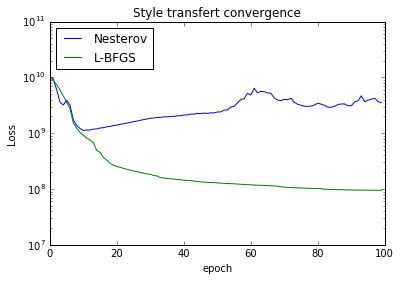

In [59]:
plt.figure()
ax = plt.gca()
ax.set_yscale('log')
plt.plot(losses)
plt.plot(loss_lbfgs)

plt.title('Style transfert convergence')
plt.ylabel('Loss')
plt.xlabel('epoch')
plt.legend(['Nesterov', 'L-BFGS'], loc='upper left')

In [61]:
imsave("chien_van_gogh_2.jpg",img_toshow)